![Wines](https://scontent.fbud6-3.fna.fbcdn.net/v/t1.6435-9/153559093_3120498531386912_5733115463283350166_n.jpg?_nc_cat=109&ccb=1-7&_nc_sid=cc71e4&_nc_ohc=yU3Losj9o-cQ7kNvwF43JOH&_nc_oc=Adn3cA3JQEJ_IJZ0XTMlE3gwjWgFZsY1rkSA0NmF13CxPTrKj8C1tqziKwrJIa8Fxuc&_nc_zt=23&_nc_ht=scontent.fbud6-3.fna&_nc_gid=mPMmX2gph-5LsVzJIfWSCg&oh=00_AYH1Dh04dqVi6C_FeZ5mfK47Ve1gqfIxCKVslMTg_aQmzw&oe=6818789D)

# Wine quality analysis

### Introduction

I used the [Wine Quality](https://archive.ics.uci.edu/dataset/186/wine+quality) dataset available at the UC Irvine Machine Learning Repository. This dataset contains physicochemical and quality-related data about <em>vinho verde</em>, a unique wine produced in the northern region of Portugal. The data is divided into two subsets: red and white wine samples. 

The main goal of my analysis is to investigate which features have the greatest influence on the wine's quality and to determine whether their impact is positive or negative.


### Features

| Feature               | Unit                         | Description                                                                                              |
|----------------------|------------------------------|----------------------------------------------------------------------------------------------------------|
| Fixed acidity        | g (tartaric acid)/dm³         | The amount of non-volatile acids (mainly tartaric and malic acid) that do not evaporate during fermentation. |
| Volatile acidity     | g (acetic acid)/dm³           | The amount of acetic acid present. High levels can cause an undesirable vinegar-like aroma and spoilage.  |
| Citric acid          | g/dm³                        | Naturally occurring acid in small quantities. Enhances freshness in the wine.      |
| Residual sugar       | g/dm³                        | The amount of sugar remaining after fermentation. Higher values result in a sweeter taste, while lower values indicate a drier wine. |
| Chlorides            | g (sodium chloride)/dm³       | The concentration of sodium chloride (salt) in the wine. |
| Free sulfur dioxide  | mg/dm³                       | The portion of sulfur dioxide (SO₂) unbound in the wine, acting as a preservative against oxidation and microbial spoilage. |
| Total sulfur dioxide | mg/dm³                       | The total amount of both free and bound sulfur dioxide. Excessive concentrations may negatively impact aroma and flavor. |
| Density              | g/cm³                        | The density of the wine. |
| pH                   | -                            | Measures the strength of acidity on the pH scale (0 = highly acidic, 14 = highly alkaline). |
| Sulphates            | g (potassium sulphate)/dm³    | Additive used for its antioxidant and antimicrobial properties. May slightly increase bitterness and improve preservation. |
| Alcohol              | %                       | The percentage of ethyl alcohol in the wine. |


The target variable is the wine quality, represented as a score on a scale from 0 to 10.

In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
from ydata_profiling import ProfileReport
from pandas.plotting import parallel_coordinates

In [2]:
# Read in the red wine data to a dataframe
df_red = pd.read_csv("winequality-red.csv", sep=";")

# Read in the white wine data to a dataframe
df_white = pd.read_csv("winequality-white.csv", sep=";")

In [3]:
df_red

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5
1,7.8,0.880,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8,5
2,7.8,0.760,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8,5
3,11.2,0.280,0.56,1.9,0.075,17.0,60.0,0.99800,3.16,0.58,9.8,6
4,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5
...,...,...,...,...,...,...,...,...,...,...,...,...
1594,6.2,0.600,0.08,2.0,0.090,32.0,44.0,0.99490,3.45,0.58,10.5,5
1595,5.9,0.550,0.10,2.2,0.062,39.0,51.0,0.99512,3.52,0.76,11.2,6
1596,6.3,0.510,0.13,2.3,0.076,29.0,40.0,0.99574,3.42,0.75,11.0,6
1597,5.9,0.645,0.12,2.0,0.075,32.0,44.0,0.99547,3.57,0.71,10.2,5


In [4]:
df_white

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.00100,3.00,0.45,8.8,6
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.99400,3.30,0.49,9.5,6
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.99510,3.26,0.44,10.1,6
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.99560,3.19,0.40,9.9,6
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.99560,3.19,0.40,9.9,6
...,...,...,...,...,...,...,...,...,...,...,...,...
4893,6.2,0.21,0.29,1.6,0.039,24.0,92.0,0.99114,3.27,0.50,11.2,6
4894,6.6,0.32,0.36,8.0,0.047,57.0,168.0,0.99490,3.15,0.46,9.6,5
4895,6.5,0.24,0.19,1.2,0.041,30.0,111.0,0.99254,2.99,0.46,9.4,6
4896,5.5,0.29,0.30,1.1,0.022,20.0,110.0,0.98869,3.34,0.38,12.8,7


The dataset includes 1599 red wine samples and 4898 white wine samples. This difference is likely because vinho verde is more commonly produced as a white wine.

### White and red wine characteristics

The analysis will be performed on both red and white wines, but the results may differ due to their distinct characteristics. The table below shows the distribution of all features for both red and white wines in order to compare them.

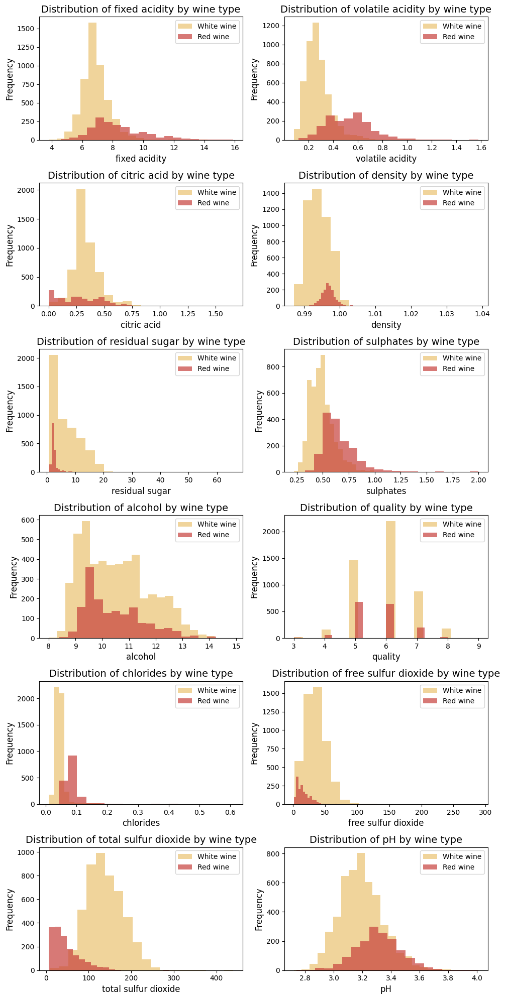

In [5]:
# List of features to compare
features = ['fixed acidity', 'volatile acidity', 'citric acid', 'density', 'residual sugar', 
            'sulphates', 'alcohol', 'quality', 'chlorides', 'free sulfur dioxide', 
            'total sulfur dioxide', 'pH']

# Set the number of rows and columns for the subplots
n_rows = 6 
n_cols = 2

# Create subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(10, 20))

# Flatten the axes array for easy access
axes = axes.flatten()

# Plot each feature for both red and white wines
for i, feature in enumerate(features):
    # Plot for white wines (column 1)
    axes[i].hist(df_white[feature], bins=20, color='#eac371', alpha=0.7, label='White wine')
    
    # Plot for red wines (column 2)
    axes[i].hist(df_red[feature], bins=20, color='#c7413c', alpha=0.7, label='Red wine')
    
    # Set labels and titles
    axes[i].set_xlabel(feature, fontsize=12)
    axes[i].set_ylabel('Frequency', fontsize=12)
    axes[i].set_title(f'Distribution of {feature} by wine type', fontsize=14)
    axes[i].legend()

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

### Observations:

- **Red wines** tend to have higher acidity, reflected in their higher levels of **volatile acidity** and **fixed acidity**.
- **Red wines** generally contain more **sulphates**, which may be related to the winemaking process, such as longer fermentation and aging periods.
- **White wines** typically have higher levels of **residual sugar**, which is consistent with the general characteristic of white wines being sweeter, while red wines are typically drier.
- **White wines** contain more **sulfur dioxide**, which is used as a preservative.


In [6]:
# Run the profiling for red wine
profile = ProfileReport(df_red, title="Red wine")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<?, ?it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
# Run the profiling for white wine
profile = ProfileReport(df_white, title="White wine")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|███████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 23842.56it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Neither of the datasets contains missing values. However, both of them include duplicate rows: the red wine dataset contains 220 duplicate rows, while the white wine dataset contains 772 duplicate rows.

## Quality

First, I examined the target value which is wine quality.

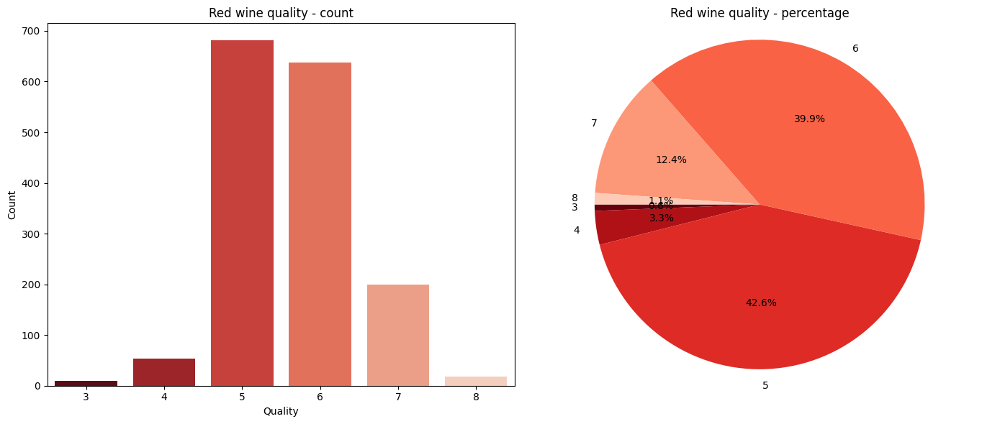

In [8]:
# Count the occurrences of each quality value and sort the results
quality_counts = df_red['quality'].value_counts().sort_index()

# Create a figure with 1 row and 2 columns for the subplots
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

# Create custom color palette
reds_palette = plt.cm.Reds_r(np.linspace(0, 0.8, len(quality_counts))).tolist()

# Left plot: countplot using Seaborn to show the distribution of wine quality
sns.countplot(x='quality', hue='quality', data=df_red, ax=axs[0], palette=reds_palette, legend=False)
# Set the title, x-axis label, and y-axis label for the left plot
axs[0].set_title('Red wine quality - count')
axs[0].set_xlabel('Quality')
axs[0].set_ylabel('Count')

# Right plot: pie chart showing the percentage distribution of wine quality
axs[1].pie(quality_counts,
           labels=quality_counts.index,
           autopct='%1.1f%%',  
           startangle=180,    
           colors=reds_palette)  # Set color gradient
# Set the title for the pie chart
axs[1].set_title('Red wine quality - percentage')
# Ensure the pie chart is a circle by making the aspect ratio equal
axs[1].axis('equal')

# Automatically adjust subplots to avoid overlap
plt.tight_layout()

# Show the plot with both the countplot and the pie chart
plt.show()


The red wine quality ratings are concentrated within a relatively narrow range of 3 to 8, indicating that the wines are neither extremely poor nor exceptional. The distribution of quality ratings is notably asymmetric, with 82.5% of wines receiving a score of either 5 or 6. This skew towards the middle values is clearly visible in both the countplot and the pie chart, highlighting the predominance of moderate-quality wines in the dataset.

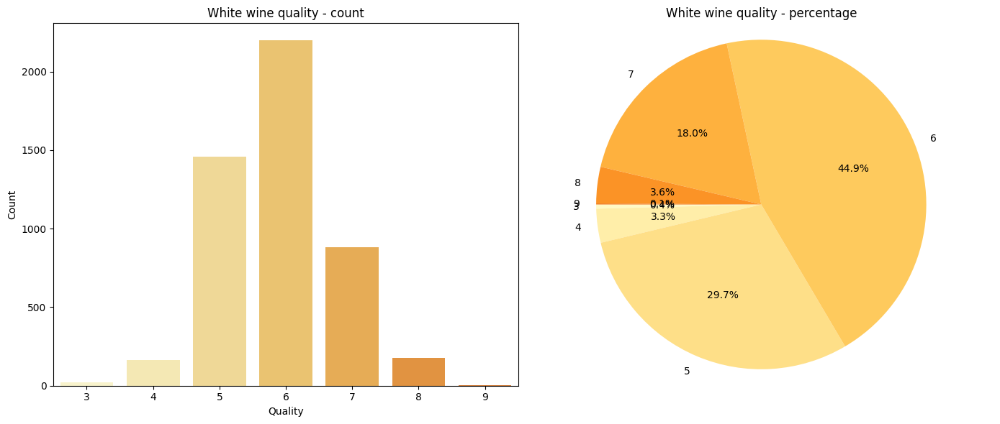

In [9]:
# Count the occurrences of each quality value and sort the results
quality_counts = df_white['quality'].value_counts().sort_index()

# Create a figure with 1 row and 2 columns for the subplots
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

# Create custom color palette
whites_palette = plt.cm.YlOrBr(np.linspace(0.1, 0.6, len(quality_counts))).tolist()


# Left plot: countplot using Seaborn to show the distribution of wine quality
sns.countplot(x='quality', hue='quality', data=df_white, ax=axs[0], palette=whites_palette, legend=False)
# Set the title, x-axis label, and y-axis label for the left plot
axs[0].set_title('White wine quality - count')
axs[0].set_xlabel('Quality')
axs[0].set_ylabel('Count')

# Right plot: pie chart showing the percentage distribution of wine quality
axs[1].pie(quality_counts,
           labels=quality_counts.index,
           autopct='%1.1f%%',  
           startangle=180,    
           colors=whites_palette)  # Set color gradient
# Set the title for the pie chart
axs[1].set_title('White wine quality - percentage')
# Ensure the pie chart is a circle by making the aspect ratio equal
axs[1].axis('equal')

# Automatically adjust subplots to avoid overlap
plt.tight_layout()

# Show the plot with both the countplot and the pie chart
plt.show()


The quality ratings for white wine cover a broader range than those for red wine, spanning from 3 to 9. While the distribution remains uneven, a considerably higher number of white wines fall into the higher quality categories (7 and above), with over 1000 samples meeting this threshold, compared to only 217 red wines. Despite this, the majority of both white and red wines fall within the mid-range quality levels, with 74.6% of white wines receiving a rating of 5 or 6.

### Correlation of features with wine quality

After analyzing the heatmap in the profiling reports, I identified <b>alcohol</b> as the feature with the strongest positive correlation with wine quality for both red and white wine. However, the features with the most negative correlations differed: <b>volatile acidity</b> showed the most negative correlation with red wine quality, while <b>clorides</b> and <b>density</b> had the strongest negative correlations with white wine quality. The table below shows the correlation values for each feature, as reported in the profiling analysis.



| Feature               | Red Wine | White Wine |
|----------------------|----------|------------|
| **Alcohol**          | 0.479    | 0.440      |
| **Sulphates**        | 0.377    | 0.033      |
| **Citric Acid**      | 0.213    | 0.018      |
| **Fixed Acidity**    | 0.114    | -0.084     |
| **Residual Sugar**   | 0.032    | -0.082     |
| **pH**               | -0.044   | 0.109      |
| **Free Sulfur Dioxide** | -0.057 | 0.024      |
| **Density**          | -0.177   | -0.348     |
| **Chlorides**        | -0.190   | -0.314     |
| **Total Sulfur Dioxide** | -0.197 | -0.197   |
| **Volatile Acidity** | -0.381   | -0.197     |


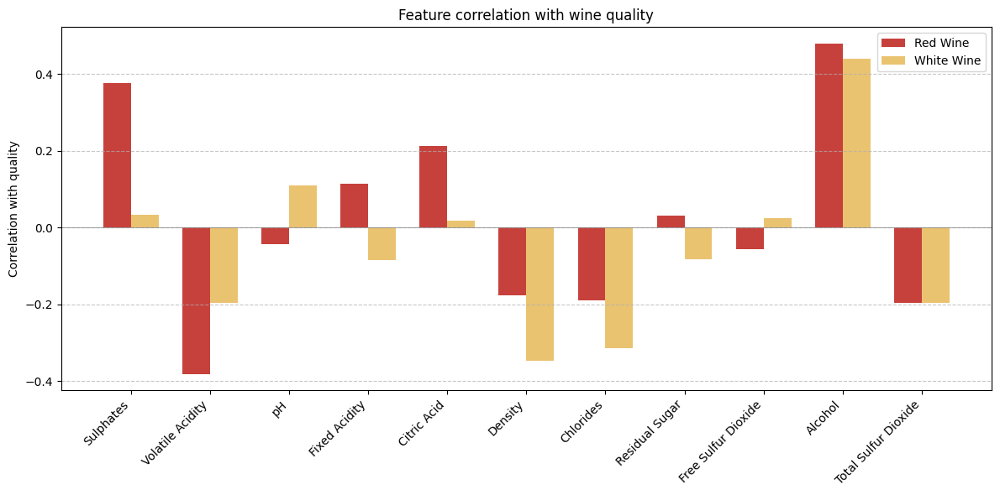

In [10]:
features = [
    "Sulphates", "Volatile Acidity", "pH", "Fixed Acidity", "Citric Acid",
    "Density", "Chlorides", "Residual Sugar", "Free Sulfur Dioxide", "Alcohol", "Total Sulfur Dioxide"
]
red_corr = [0.377, -0.381, -0.044, 0.114, 0.213, -0.177, -0.190, 0.032, -0.057, 0.479, -0.197]
white_corr = [0.033, -0.197, 0.109, -0.084, 0.018, -0.348, -0.314, -0.082, 0.024, 0.440, -0.197]

x = np.arange(len(features))
width = 0.35

# Plot
plt.figure(figsize=(12, 6))
plt.bar(x - width/2, red_corr, width, label='Red Wine', color='#c7413c')
plt.bar(x + width/2, white_corr, width, label='White Wine', color='#eac371')

plt.axhline(0, color='gray', linewidth=0.5)
plt.ylabel('Correlation with quality')
plt.title('Feature correlation with wine quality')
plt.xticks(x, features, rotation=45, ha='right')
plt.legend()
plt.tight_layout()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


### Observations

- **Alcohol content** shows a strong positive correlation with wine quality in both red and white wines, making it the most influential feature overall.
- **Sulphates** have the second strongest positive influence on red wine quality, whereas they show minimal impact on white wine quality.
- **pH** demonstrates a moderate positive influence on white wine quality, while it has a slightly negative correlation with red wine quality, which was quite surprising.
- **Citric acid** contributes positively to red wine quality, but appears to be the least impactful feature in white wines.
- **Volatile acidity** negatively affects both wine types, with nearly double the negative correlation in red wines compared to white wines.
- **Density** and **chlorides** both have negative correlations with wine quality in red and white wines, but these effects are significantly stronger in white wines.
- **Total sulfur dioxide** shows exactly the same negative impact on both red and white wine quality.
- **Residual sugar** and **free sulfur dioxide** display opposing correlations in red and white wines. However, since their impact is quite small, they might be good candidates for removal in future feature selection.


## Other correlating features

#### Red Wine
- Citric acid correlates with:
  - Fixed acidity
  - pH
  - Volatile acidity
- Density correlates with:
  - Fixed acidity
- Fixed acidity correlates with:
  - Citric acid
  - Density
  - pH
- Free sulfur dioxide correlates with:
  - Total sulfur dioxide
- pH correlates with:
  - Citric acid
  - Fixed acidity
- Total sulfur dioxide correlates with:
  - Free sulfur dioxide
- Volatile acidity correlates with:
  - Citric acid

> In red wine, acidity-related features are strongly connected. Higher fixed acidity often comes with more citric acid and lower pH (more acidic wine). Sulfur dioxide levels also show a clear relationship.

#### White Wine
- Alcohol correlates with:
  - Chlorides
  - Density
- Chlorides correlate with:
  - Alcohol
  - Density
- Density correlates with:
  - Alcohol
  - Chlorides
  - Residual sugar
  - Total sulfur dioxide
- Free sulfur dioxide correlates with:
  - Total sulfur dioxide
- Residual sugar correlates with:
  - Density
- Total sulfur dioxide correlates with:
  - Density
  - Free sulfur dioxide

> In white wine, the most important correlations are around density. Higher density usually means more residual sugar and lower alcohol content. Sulfur dioxide levels again correlate with each other, while alcohol content is negatively correlated with density and chlorides.


In the following section, I examine the strongest correlations between the features in both the red and white wine datasets. To support the analysis and provide better understanding, I use visualizations to highlight the most significant relationships between the variables.

### Total sulfur dioxide and free sulfur dioxide

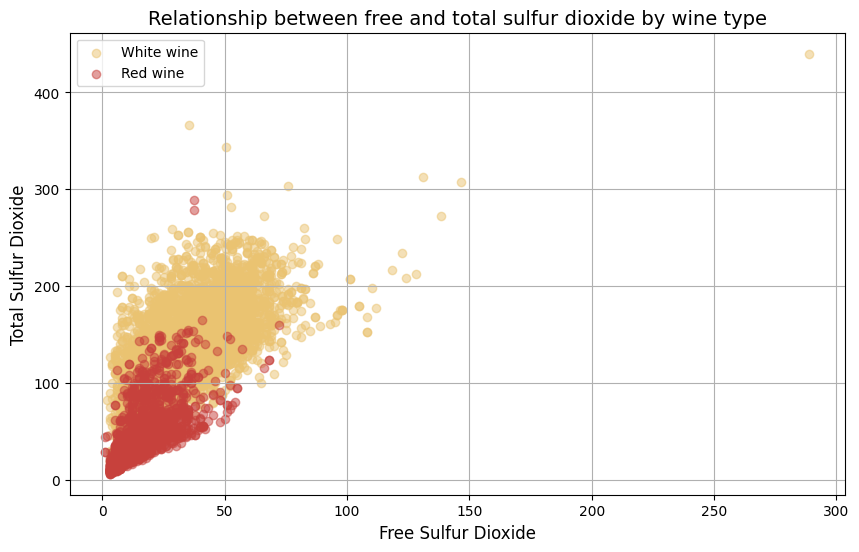

In [11]:
# Set figure size
plt.figure(figsize=(10, 6))

# Scatter plot for white wines
plt.scatter(
    df_white['free sulfur dioxide'], 
    df_white['total sulfur dioxide'],
    color='#eac371', 
    alpha=0.5, 
    label='White wine'
)

# Scatter plot for red wines
plt.scatter(
    df_red['free sulfur dioxide'], 
    df_red['total sulfur dioxide'], 
    color='#c7413c',  
    alpha=0.5, 
    label='Red wine'
)

# Axis labels and title
plt.xlabel('Free Sulfur Dioxide', fontsize=12)
plt.ylabel('Total Sulfur Dioxide', fontsize=12)
plt.title('Relationship between free and total sulfur dioxide by wine type', fontsize=14)

# Add legend and grid
plt.legend()
plt.grid(True)

# Show the plot
plt.show()


Free sulfur dioxide and total sulfur dioxide show a very high positive correlation in both the red and white wine datasets, which is expected, as free sulfur dioxide is part of total sulfur dioxide. Previous analysis showed that free sulfur dioxide has little correlation with wine quality, so it may be useful to keep only total sulfur dioxide, as it also includes information about free sulfur dioxide. The scatter plot also shows that white wines have higher levels of sulfur dioxide compared to red wines, which is consistent with the expectations.

### Alcohol content and density

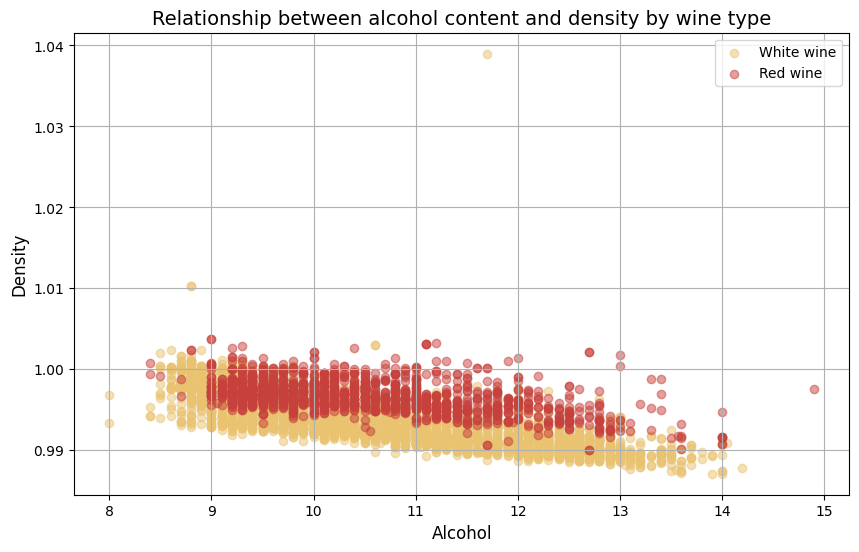

In [12]:
# Set figure size
plt.figure(figsize=(10, 6))

# Scatter plot for white wines
plt.scatter(
    df_white['alcohol'], 
    df_white['density'],
    color='#eac371', 
    alpha=0.5, 
    label='White wine'
)

# Scatter plot for red wines
plt.scatter(
    df_red['alcohol'], 
    df_red['density'], 
    color='#c7413c',  
    alpha=0.5, 
    label='Red wine'
)

# Axis labels and title
plt.xlabel('Alcohol', fontsize=12)
plt.ylabel('Density', fontsize=12)
plt.title('Relationship between alcohol content and density by wine type', fontsize=14)

# Add legend and grid
plt.legend()
plt.grid(True)

# Show the plot
plt.show()


Alcohol content and density show a high negative correlation, especially in white wines. This relationship is logical, as alcohol is less dense than water. Therefore, as the alcohol content increases, the density of the wine tends to decrease.

### Residual sugar and density

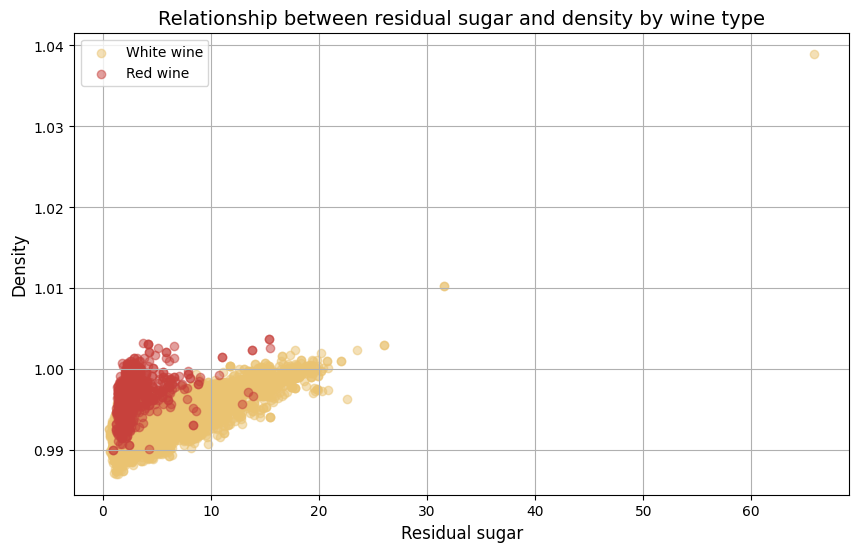

In [13]:
# Set figure size
plt.figure(figsize=(10, 6))

# Scatter plot for white wines
plt.scatter(
    df_white['residual sugar'], 
    df_white['density'],
    color='#eac371', 
    alpha=0.5, 
    label='White wine'
)

# Scatter plot for red wines
plt.scatter(
    df_red['residual sugar'], 
    df_red['density'], 
    color='#c7413c',  
    alpha=0.5, 
    label='Red wine'
)

# Axis labels and title
plt.xlabel('Residual sugar', fontsize=12)
plt.ylabel('Density', fontsize=12)
plt.title('Relationship between residual sugar and density by wine type', fontsize=14)

# Add legend and grid
plt.legend()
plt.grid(True)

# Show the plot
plt.show()


In white wines, residual sugar shows a positive correlation with density. This is because density is also influenced by the presence of solids, such as sugars and acids, which contribute to the wine's overall density. However, this correlation is less evident in red wines.

### Fixed acidity and pH

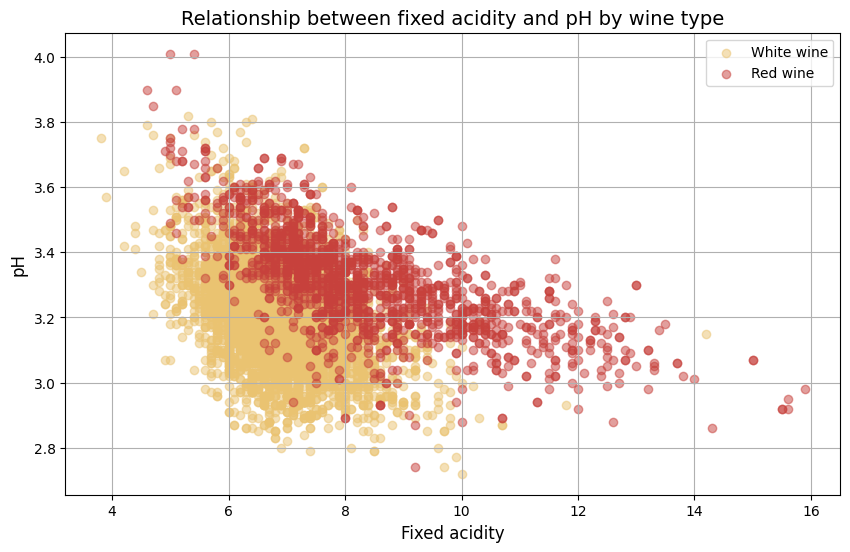

In [14]:
# Set figure size
plt.figure(figsize=(10, 6))

# Scatter plot for white wines
plt.scatter(
    df_white['fixed acidity'], 
    df_white['pH'],
    color='#eac371', 
    alpha=0.5, 
    label='White wine'
)

# Scatter plot for red wines
plt.scatter(
    df_red['fixed acidity'], 
    df_red['pH'], 
    color='#c7413c',  
    alpha=0.5, 
    label='Red wine'
)

# Axis labels and title
plt.xlabel('Fixed acidity', fontsize=12)
plt.ylabel('pH', fontsize=12)
plt.title('Relationship between fixed acidity and pH by wine type', fontsize=14)

# Add legend and grid
plt.legend()
plt.grid(True)

# Show the plot
plt.show()


The negative correlation between pH and fixed acidity is expected, as higher fixed acidity results in a greater concentration of hydrogen ions, which lowers the pH. In other words, wines with higher acidity have lower pH values.

## Summary

This dataset appears suitable for identifying the most influential features related to wine quality. However, working with the white wine dataset might be more advantageous, as it contains more samples from higher quality wines. Therefore, downsampling the wines rated 5 and 6 could help create a more balanced dataset, making it more suitable for AI models. The correlation between wine quality and other featuress was not particularly high, but alcohol content showed the strongest correlation. Many features had varying levels of influence depending on the wine type, which is likely due to the distinct characteristics of different wines.